<a href="https://colab.research.google.com/github/HeartBeat1608/GAN_for_MNIST/blob/master/Gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

import keras
from keras.models import Sequential, Model
from keras.layers.advanced_activations import LeakyReLU
from keras.layers import Dense, Conv2D, Dropout, Input
from keras.datasets import mnist
from tqdm import tqdm
from keras.optimizers import Adam

Using TensorFlow backend.


In [2]:
tf.test.gpu_device_name()

'/device:GPU:0'

In [0]:
def load_data():
  (x_train, y_train), (x_test, y_test) = mnist.load_data()
  x_train = (x_train.astype(np.float32) - 127.5) / 127.5
  x_train = x_train.reshape(60000, 784)
  return (x_train, y_train, x_test, y_test)

In [4]:
(X_train, Y_train, X_test, Y_test) = load_data()
print(X_train.shape)

(60000, 784)


In [0]:
def adam_optimizer():
  return Adam(lr=0.001, beta_1=0.5)

In [6]:
def create_generator():
  generator = Sequential()
  generator.add(Dense(units=256, input_dim=100, name='Dense_1'))
  generator.add(LeakyReLU(0.2, name='ReLU_1'))
  generator.add(Dense(units=512, name='Dense_2'))
  generator.add(LeakyReLU(0.2, name='ReLU_2'))
  generator.add(Dense(units=1024, name='Dense_3'))
  generator.add(LeakyReLU(0.2, name='ReLU_3'))
  generator.add(Dense(units=784, activation='tanh', name='Dense_4'))
  
  generator.compile(loss='binary_crossentropy', optimizer=adam_optimizer())
  return generator

create_generator().summary()

W0702 13:37:04.311692 140016500504448 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0702 13:37:04.314628 140016500504448 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0702 13:37:04.325232 140016500504448 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0702 13:37:04.385833 140016500504448 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0702 13:37:04.391600 140016500504448 deprecation_wrappe

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Dense_1 (Dense)              (None, 256)               25856     
_________________________________________________________________
ReLU_1 (LeakyReLU)           (None, 256)               0         
_________________________________________________________________
Dense_2 (Dense)              (None, 512)               131584    
_________________________________________________________________
ReLU_2 (LeakyReLU)           (None, 512)               0         
_________________________________________________________________
Dense_3 (Dense)              (None, 1024)              525312    
_________________________________________________________________
ReLU_3 (LeakyReLU)           (None, 1024)              0         
_________________________________________________________________
Dense_4 (Dense)              (None, 784)               803600    
Total para

In [7]:
def create_discriminator():
  disc = Sequential()
  disc.add(Dense(units=1024, input_dim=784, name='Dense_1'))
  disc.add(LeakyReLU(0.2, name='ReLU_1'))
  disc.add(Dense(units=512, name='Dense_2'))
  disc.add(LeakyReLU(0.2, name='ReLU_2'))
  disc.add(Dense(units=256, name='Dense_3'))
  disc.add(LeakyReLU(0.2, name='ReLU_3'))
  disc.add(Dense(units=1, activation='sigmoid', name='Dense_4'))
  disc.compile(loss='binary_crossentropy', optimizer=adam_optimizer())
  return disc

create_discriminator().summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Dense_1 (Dense)              (None, 1024)              803840    
_________________________________________________________________
ReLU_1 (LeakyReLU)           (None, 1024)              0         
_________________________________________________________________
Dense_2 (Dense)              (None, 512)               524800    
_________________________________________________________________
ReLU_2 (LeakyReLU)           (None, 512)               0         
_________________________________________________________________
Dense_3 (Dense)              (None, 256)               131328    
_________________________________________________________________
ReLU_3 (LeakyReLU)           (None, 256)               0         
_________________________________________________________________
Dense_4 (Dense)              (None, 1)                 257       
Total para

In [0]:
def create_gan(gen, disc):
  disc.trainable = False
  gan_input = Input(shape=(100,))
  x = gen(gan_input)
  gan_out = disc(x)
  gan = Model(inputs=gan_input, outputs = gan_out)
  gan.compile(loss='binary_crossentropy', optimizer='adam')
  return gan

In [0]:
def plot_images(epochs, gen, examples=100, dim=(10, 10), figsize=(10, 10)):
  noise = np.random.normal(loc=0, scale=1, size=[examples, 100])
  gen_img = gen.predict(noise)
  gen_img = gen_img.reshape(100, 28, 28)
  plt.figure(figsize=figsize)
  for i in range(gen_img.shape[0]):
    plt.subplot(dim[0], dim[1], i+1)
    plt.imshow(gen_img[i], interpolation='nearest')
    plt.axis('off')
  plt.tight_layout()
  plt.savefig(f'generated_image_{epochs}.png')

In [0]:
def training(epochs=1, batch_size=128):
  (X_train, Y_train, X_test, Y_test) = load_data()
  batch_count = X_train.shape[0] / batch_size
  
  gen = create_generator()
  disc = create_discriminator()
  gan = create_gan(gen, disc)
  
  for e in range(1, epochs+1):
    print(f'Epoch : {e}')
    for _ in tqdm(range(batch_size)):
      noise = np.random.normal(loc=0, scale=1, size=[batch_size, 100])
      gen_img = gen.predict(noise)
      img_batch = X_train[np.random.randint(low=0, high=X_train.shape[0], size=batch_size)]
      X = np.concatenate([img_batch, gen_img])
      y_dis = np.zeros(2*batch_size)
      y_dis[:batch_size] = 0.9
      
      disc.trainable = True
      disc.train_on_batch(X, y_dis)
      
      noise = np.random.normal(loc=0, scale=1, size=[batch_size, 100])
      y_dis = np.ones(batch_size)
      
      disc.trainable = False
      
      gan.train_on_batch(noise, y_dis)
      
      if e == 1 or e % 100 == 0:
        plot_images(e, gen)
        


  0%|          | 0/64 [00:00<?, ?it/s]W0702 13:37:05.350564 140016500504448 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:2741: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.



Epoch : 1


 31%|███▏      | 20/64 [01:04<02:11,  2.98s/it]/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
 12%|█▎        | 8/64 [00:00<00:00, 74.18it/s]

Epoch : 2


 14%|█▍        | 9/64 [00:00<00:00, 86.94it/s]

Epoch : 3


 16%|█▌        | 10/64 [00:00<00:00, 91.71it/s]

Epoch : 4


 14%|█▍        | 9/64 [00:00<00:00, 87.48it/s]

Epoch : 5


 14%|█▍        | 9/64 [00:00<00:00, 80.33it/s]

Epoch : 6


 14%|█▍        | 9/64 [00:00<00:00, 89.83it/s]

Epoch : 7


 16%|█▌        | 10/64 [00:00<00:00, 97.33it/s]

Epoch : 8


 16%|█▌        | 10/64 [00:00<00:00, 91.20it/s]

Epoch : 9


 14%|█▍        | 9/64 [00:00<00:00, 82.41it/s]

Epoch : 10


 16%|█▌        | 10/64 [00:00<00:00, 94.82it/s]

Epoch : 11


 14%|█▍        | 9/64 [00:00<00:00, 89.56it/s]

Epoch : 12


 16%|█▌        | 10/64 [00:00<00:00, 99.93it/s]

Epoch : 13


 16%|█▌        | 10/64 [00:00<00:00, 95.28it/s]

Epoch : 14


 16%|█▌        | 10/64 [00:00<00:00, 95.27it/s]

Epoch : 15


 16%|█▌        | 10/64 [00:00<00:00, 92.64it/s]

Epoch : 16


 16%|█▌        | 10/64 [00:00<00:00, 95.12it/s]

Epoch : 17


 14%|█▍        | 9/64 [00:00<00:00, 86.73it/s]

Epoch : 18


 16%|█▌        | 10/64 [00:00<00:00, 94.89it/s]

Epoch : 19


 14%|█▍        | 9/64 [00:00<00:00, 89.38it/s]

Epoch : 20


 16%|█▌        | 10/64 [00:00<00:00, 95.27it/s]

Epoch : 21


 16%|█▌        | 10/64 [00:00<00:00, 94.89it/s]

Epoch : 22


 14%|█▍        | 9/64 [00:00<00:00, 89.12it/s]

Epoch : 23


 16%|█▌        | 10/64 [00:00<00:00, 93.95it/s]

Epoch : 24


 16%|█▌        | 10/64 [00:00<00:00, 96.07it/s]

Epoch : 25


 14%|█▍        | 9/64 [00:00<00:00, 87.10it/s]

Epoch : 26


 16%|█▌        | 10/64 [00:00<00:00, 96.54it/s]

Epoch : 27


 16%|█▌        | 10/64 [00:00<00:00, 97.97it/s]

Epoch : 28


 16%|█▌        | 10/64 [00:00<00:00, 95.09it/s]

Epoch : 29


 16%|█▌        | 10/64 [00:00<00:00, 89.93it/s]

Epoch : 30


 16%|█▌        | 10/64 [00:00<00:00, 90.63it/s]

Epoch : 31


 16%|█▌        | 10/64 [00:00<00:00, 97.98it/s]

Epoch : 32


 16%|█▌        | 10/64 [00:00<00:00, 93.67it/s]

Epoch : 33


 16%|█▌        | 10/64 [00:00<00:00, 95.50it/s]

Epoch : 34


 14%|█▍        | 9/64 [00:00<00:00, 89.24it/s]

Epoch : 35


 14%|█▍        | 9/64 [00:00<00:00, 84.42it/s]

Epoch : 36


 14%|█▍        | 9/64 [00:00<00:00, 87.02it/s]

Epoch : 37


 16%|█▌        | 10/64 [00:00<00:00, 94.64it/s]

Epoch : 38


 14%|█▍        | 9/64 [00:00<00:00, 88.43it/s]

Epoch : 39


 14%|█▍        | 9/64 [00:00<00:00, 89.10it/s]

Epoch : 40


 16%|█▌        | 10/64 [00:00<00:00, 92.33it/s]

Epoch : 41


 16%|█▌        | 10/64 [00:00<00:00, 90.08it/s]

Epoch : 42


 14%|█▍        | 9/64 [00:00<00:00, 89.29it/s]

Epoch : 43


 16%|█▌        | 10/64 [00:00<00:00, 91.88it/s]

Epoch : 44


 16%|█▌        | 10/64 [00:00<00:00, 97.67it/s]

Epoch : 45


 16%|█▌        | 10/64 [00:00<00:00, 99.16it/s]

Epoch : 46


 14%|█▍        | 9/64 [00:00<00:00, 89.42it/s]

Epoch : 47


 14%|█▍        | 9/64 [00:00<00:00, 85.47it/s]

Epoch : 48


 14%|█▍        | 9/64 [00:00<00:00, 87.51it/s]

Epoch : 49


 14%|█▍        | 9/64 [00:00<00:00, 89.99it/s]

Epoch : 50


 16%|█▌        | 10/64 [00:00<00:00, 90.85it/s]

Epoch : 51


 12%|█▎        | 8/64 [00:00<00:00, 78.87it/s]

Epoch : 52


 16%|█▌        | 10/64 [00:00<00:00, 92.51it/s]

Epoch : 53


 16%|█▌        | 10/64 [00:00<00:00, 93.46it/s]

Epoch : 54


 14%|█▍        | 9/64 [00:00<00:00, 85.56it/s]

Epoch : 55


 16%|█▌        | 10/64 [00:00<00:00, 92.43it/s]

Epoch : 56


 16%|█▌        | 10/64 [00:00<00:00, 99.50it/s]

Epoch : 57


 16%|█▌        | 10/64 [00:00<00:00, 93.22it/s]

Epoch : 58


 16%|█▌        | 10/64 [00:00<00:00, 96.99it/s]

Epoch : 59


 16%|█▌        | 10/64 [00:00<00:00, 99.94it/s]

Epoch : 60


 16%|█▌        | 10/64 [00:00<00:00, 95.42it/s]

Epoch : 61


 16%|█▌        | 10/64 [00:00<00:00, 96.98it/s]

Epoch : 62


 16%|█▌        | 10/64 [00:00<00:00, 93.28it/s]

Epoch : 63


 16%|█▌        | 10/64 [00:00<00:00, 95.63it/s]

Epoch : 64


 16%|█▌        | 10/64 [00:00<00:00, 95.41it/s]

Epoch : 65


 16%|█▌        | 10/64 [00:00<00:00, 93.81it/s]

Epoch : 66


 16%|█▌        | 10/64 [00:00<00:00, 96.82it/s]

Epoch : 67


 14%|█▍        | 9/64 [00:00<00:00, 83.93it/s]

Epoch : 68


 17%|█▋        | 11/64 [00:00<00:00, 100.71it/s]

Epoch : 69


 16%|█▌        | 10/64 [00:00<00:00, 93.17it/s]

Epoch : 70


 16%|█▌        | 10/64 [00:00<00:00, 92.08it/s]

Epoch : 71


 16%|█▌        | 10/64 [00:00<00:00, 95.57it/s]

Epoch : 72


 16%|█▌        | 10/64 [00:00<00:00, 92.72it/s]

Epoch : 73


 16%|█▌        | 10/64 [00:00<00:00, 93.57it/s]

Epoch : 74


 16%|█▌        | 10/64 [00:00<00:00, 94.93it/s]

Epoch : 75


 16%|█▌        | 10/64 [00:00<00:00, 98.91it/s]

Epoch : 76


 16%|█▌        | 10/64 [00:00<00:00, 99.05it/s]

Epoch : 77


 16%|█▌        | 10/64 [00:00<00:00, 91.38it/s]

Epoch : 78


 16%|█▌        | 10/64 [00:00<00:00, 95.32it/s]

Epoch : 79


 16%|█▌        | 10/64 [00:00<00:00, 92.23it/s]

Epoch : 80


 17%|█▋        | 11/64 [00:00<00:00, 100.72it/s]

Epoch : 81


 17%|█▋        | 11/64 [00:00<00:00, 101.82it/s]

Epoch : 82


 16%|█▌        | 10/64 [00:00<00:00, 93.98it/s]

Epoch : 83


 16%|█▌        | 10/64 [00:00<00:00, 94.95it/s]

Epoch : 84


 17%|█▋        | 11/64 [00:00<00:00, 100.74it/s]

Epoch : 85


 14%|█▍        | 9/64 [00:00<00:00, 89.94it/s]

Epoch : 86


 16%|█▌        | 10/64 [00:00<00:00, 94.65it/s]

Epoch : 87


 16%|█▌        | 10/64 [00:00<00:00, 95.94it/s]

Epoch : 88


 16%|█▌        | 10/64 [00:00<00:00, 89.36it/s]

Epoch : 89


 16%|█▌        | 10/64 [00:00<00:00, 95.36it/s]

Epoch : 90


 14%|█▍        | 9/64 [00:00<00:00, 89.58it/s]

Epoch : 91


 14%|█▍        | 9/64 [00:00<00:00, 82.98it/s]

Epoch : 92


 16%|█▌        | 10/64 [00:00<00:00, 93.27it/s]

Epoch : 93


 14%|█▍        | 9/64 [00:00<00:00, 84.65it/s]

Epoch : 94


 12%|█▎        | 8/64 [00:00<00:00, 76.28it/s]

Epoch : 95


 16%|█▌        | 10/64 [00:00<00:00, 92.51it/s]

Epoch : 96


 16%|█▌        | 10/64 [00:00<00:00, 91.62it/s]

Epoch : 97


 16%|█▌        | 10/64 [00:00<00:00, 95.81it/s]

Epoch : 98


 14%|█▍        | 9/64 [00:00<00:00, 89.64it/s]

Epoch : 99


  0%|          | 0/64 [00:00<?, ?it/s]

Epoch : 100


 12%|█▎        | 8/64 [00:00<00:00, 77.90it/s]

Epoch : 101


 16%|█▌        | 10/64 [00:00<00:00, 96.10it/s]

Epoch : 102


 16%|█▌        | 10/64 [00:00<00:00, 92.16it/s]

Epoch : 103


 14%|█▍        | 9/64 [00:00<00:00, 85.59it/s]

Epoch : 104


 16%|█▌        | 10/64 [00:00<00:00, 93.09it/s]

Epoch : 105


 14%|█▍        | 9/64 [00:00<00:00, 84.69it/s]

Epoch : 106


 14%|█▍        | 9/64 [00:00<00:00, 89.34it/s]

Epoch : 107


 16%|█▌        | 10/64 [00:00<00:00, 96.17it/s]

Epoch : 108


 16%|█▌        | 10/64 [00:00<00:00, 95.79it/s]

Epoch : 109


 16%|█▌        | 10/64 [00:00<00:00, 94.44it/s]

Epoch : 110


 16%|█▌        | 10/64 [00:00<00:00, 92.78it/s]

Epoch : 111


 17%|█▋        | 11/64 [00:00<00:00, 100.64it/s]

Epoch : 112


 14%|█▍        | 9/64 [00:00<00:00, 85.62it/s]

Epoch : 113


 16%|█▌        | 10/64 [00:00<00:00, 92.61it/s]

Epoch : 114


 16%|█▌        | 10/64 [00:00<00:00, 99.45it/s]

Epoch : 115


 16%|█▌        | 10/64 [00:00<00:00, 92.72it/s]

Epoch : 116


 16%|█▌        | 10/64 [00:00<00:00, 92.48it/s]

Epoch : 117


 16%|█▌        | 10/64 [00:00<00:00, 93.21it/s]

Epoch : 118


 16%|█▌        | 10/64 [00:00<00:00, 94.19it/s]

Epoch : 119


 16%|█▌        | 10/64 [00:00<00:00, 88.26it/s]

Epoch : 120


 12%|█▎        | 8/64 [00:00<00:00, 79.54it/s]

Epoch : 121


 16%|█▌        | 10/64 [00:00<00:00, 96.55it/s]

Epoch : 122


 14%|█▍        | 9/64 [00:00<00:00, 85.68it/s]

Epoch : 123


 16%|█▌        | 10/64 [00:00<00:00, 98.23it/s]

Epoch : 124


 16%|█▌        | 10/64 [00:00<00:00, 94.51it/s]

Epoch : 125


 14%|█▍        | 9/64 [00:00<00:00, 84.52it/s]

Epoch : 126


 16%|█▌        | 10/64 [00:00<00:00, 98.64it/s]

Epoch : 127


 14%|█▍        | 9/64 [00:00<00:00, 83.40it/s]

Epoch : 128


 14%|█▍        | 9/64 [00:00<00:00, 87.92it/s]

Epoch : 129


 16%|█▌        | 10/64 [00:00<00:00, 91.57it/s]

Epoch : 130


 14%|█▍        | 9/64 [00:00<00:00, 85.49it/s]

Epoch : 131


 16%|█▌        | 10/64 [00:00<00:00, 91.57it/s]

Epoch : 132


 16%|█▌        | 10/64 [00:00<00:00, 96.65it/s]

Epoch : 133


 16%|█▌        | 10/64 [00:00<00:00, 92.72it/s]

Epoch : 134


 14%|█▍        | 9/64 [00:00<00:00, 89.77it/s]

Epoch : 135


 17%|█▋        | 11/64 [00:00<00:00, 102.09it/s]

Epoch : 136


 16%|█▌        | 10/64 [00:00<00:00, 91.13it/s]

Epoch : 137


 17%|█▋        | 11/64 [00:00<00:00, 100.60it/s]

Epoch : 138


 14%|█▍        | 9/64 [00:00<00:00, 84.90it/s]

Epoch : 139


 16%|█▌        | 10/64 [00:00<00:00, 93.50it/s]

Epoch : 140


 16%|█▌        | 10/64 [00:00<00:00, 93.89it/s]

Epoch : 141


 14%|█▍        | 9/64 [00:00<00:00, 84.63it/s]

Epoch : 142


 16%|█▌        | 10/64 [00:00<00:00, 93.86it/s]

Epoch : 143


 14%|█▍        | 9/64 [00:00<00:00, 88.18it/s]

Epoch : 144


 14%|█▍        | 9/64 [00:00<00:00, 87.78it/s]

Epoch : 145


 16%|█▌        | 10/64 [00:00<00:00, 91.65it/s]

Epoch : 146


 16%|█▌        | 10/64 [00:00<00:00, 94.96it/s]

Epoch : 147


 16%|█▌        | 10/64 [00:00<00:00, 95.70it/s]

Epoch : 148


 16%|█▌        | 10/64 [00:00<00:00, 99.83it/s]

Epoch : 149


 16%|█▌        | 10/64 [00:00<00:00, 95.15it/s]

Epoch : 150


 14%|█▍        | 9/64 [00:00<00:00, 84.77it/s]

Epoch : 151


 16%|█▌        | 10/64 [00:00<00:00, 96.13it/s]

Epoch : 152


 16%|█▌        | 10/64 [00:00<00:00, 92.72it/s]

Epoch : 153


 16%|█▌        | 10/64 [00:00<00:00, 95.40it/s]

Epoch : 154


 16%|█▌        | 10/64 [00:00<00:00, 94.84it/s]

Epoch : 155


 16%|█▌        | 10/64 [00:00<00:00, 92.73it/s]

Epoch : 156


 16%|█▌        | 10/64 [00:00<00:00, 95.96it/s]

Epoch : 157


 16%|█▌        | 10/64 [00:00<00:00, 92.15it/s]

Epoch : 158


 14%|█▍        | 9/64 [00:00<00:00, 89.37it/s]

Epoch : 159


 14%|█▍        | 9/64 [00:00<00:00, 83.71it/s]

Epoch : 160


 16%|█▌        | 10/64 [00:00<00:00, 92.10it/s]

Epoch : 161


 14%|█▍        | 9/64 [00:00<00:00, 88.88it/s]

Epoch : 162


 16%|█▌        | 10/64 [00:00<00:00, 92.09it/s]

Epoch : 163


 14%|█▍        | 9/64 [00:00<00:00, 88.92it/s]

Epoch : 164


 16%|█▌        | 10/64 [00:00<00:00, 93.89it/s]

Epoch : 165


 14%|█▍        | 9/64 [00:00<00:00, 83.89it/s]

Epoch : 166


 14%|█▍        | 9/64 [00:00<00:00, 87.80it/s]

Epoch : 167


 16%|█▌        | 10/64 [00:00<00:00, 94.95it/s]

Epoch : 168


 16%|█▌        | 10/64 [00:00<00:00, 94.48it/s]

Epoch : 169


 14%|█▍        | 9/64 [00:00<00:00, 86.99it/s]

Epoch : 170


 16%|█▌        | 10/64 [00:00<00:00, 98.86it/s]

Epoch : 171


 16%|█▌        | 10/64 [00:00<00:00, 92.46it/s]

Epoch : 172


 14%|█▍        | 9/64 [00:00<00:00, 83.80it/s]

Epoch : 173


 16%|█▌        | 10/64 [00:00<00:00, 94.84it/s]

Epoch : 174


 17%|█▋        | 11/64 [00:00<00:00, 102.33it/s]

Epoch : 175


 14%|█▍        | 9/64 [00:00<00:00, 87.26it/s]

Epoch : 176


 16%|█▌        | 10/64 [00:00<00:00, 98.10it/s]

Epoch : 177


 16%|█▌        | 10/64 [00:00<00:00, 98.44it/s]

Epoch : 178


 14%|█▍        | 9/64 [00:00<00:00, 87.70it/s]

Epoch : 179


 14%|█▍        | 9/64 [00:00<00:00, 87.66it/s]

Epoch : 180


 16%|█▌        | 10/64 [00:00<00:00, 96.63it/s]

Epoch : 181


 16%|█▌        | 10/64 [00:00<00:00, 90.80it/s]

Epoch : 182


 16%|█▌        | 10/64 [00:00<00:00, 97.22it/s]

Epoch : 183


 16%|█▌        | 10/64 [00:00<00:00, 97.22it/s]

Epoch : 184


 14%|█▍        | 9/64 [00:00<00:00, 86.35it/s]

Epoch : 185


 17%|█▋        | 11/64 [00:00<00:00, 100.62it/s]

Epoch : 186


 16%|█▌        | 10/64 [00:00<00:00, 93.95it/s]

Epoch : 187


 14%|█▍        | 9/64 [00:00<00:00, 87.50it/s]

Epoch : 188


 16%|█▌        | 10/64 [00:00<00:00, 99.19it/s]

Epoch : 189


 14%|█▍        | 9/64 [00:00<00:00, 88.31it/s]

Epoch : 190


 14%|█▍        | 9/64 [00:00<00:00, 85.95it/s]

Epoch : 191


 14%|█▍        | 9/64 [00:00<00:00, 86.08it/s]

Epoch : 192


 14%|█▍        | 9/64 [00:00<00:00, 88.19it/s]

Epoch : 193


 14%|█▍        | 9/64 [00:00<00:00, 89.36it/s]

Epoch : 194


 14%|█▍        | 9/64 [00:00<00:00, 84.44it/s]

Epoch : 195


 16%|█▌        | 10/64 [00:00<00:00, 91.86it/s]

Epoch : 196


 16%|█▌        | 10/64 [00:00<00:00, 91.49it/s]

Epoch : 197


 14%|█▍        | 9/64 [00:00<00:00, 88.76it/s]

Epoch : 198


 14%|█▍        | 9/64 [00:00<00:00, 88.41it/s]

Epoch : 199


  0%|          | 0/64 [00:00<?, ?it/s]

Epoch : 200


100%|██████████| 64/64 [03:26<00:00,  2.78s/it]


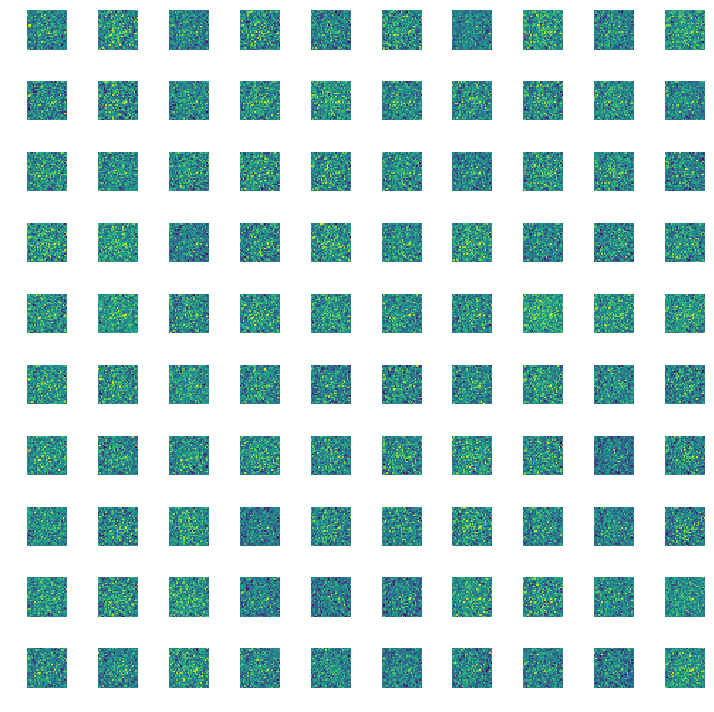

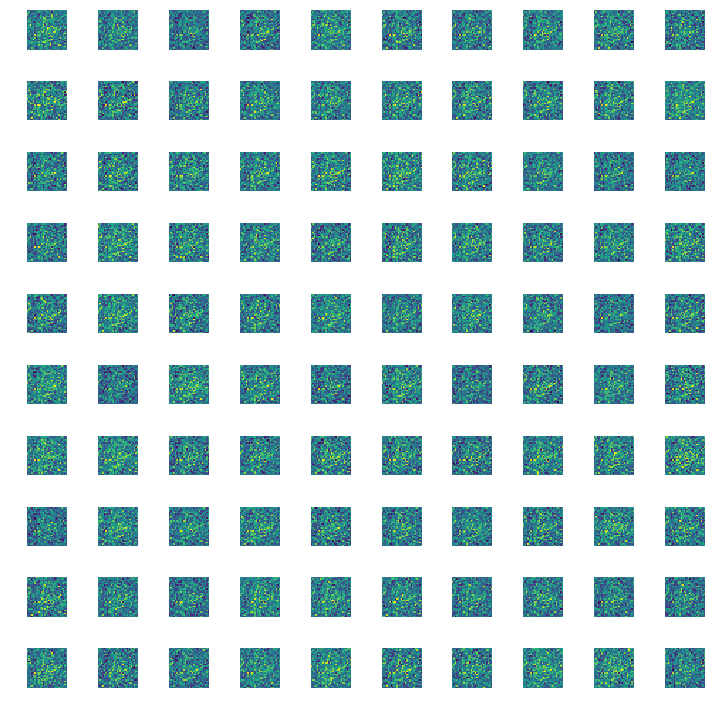

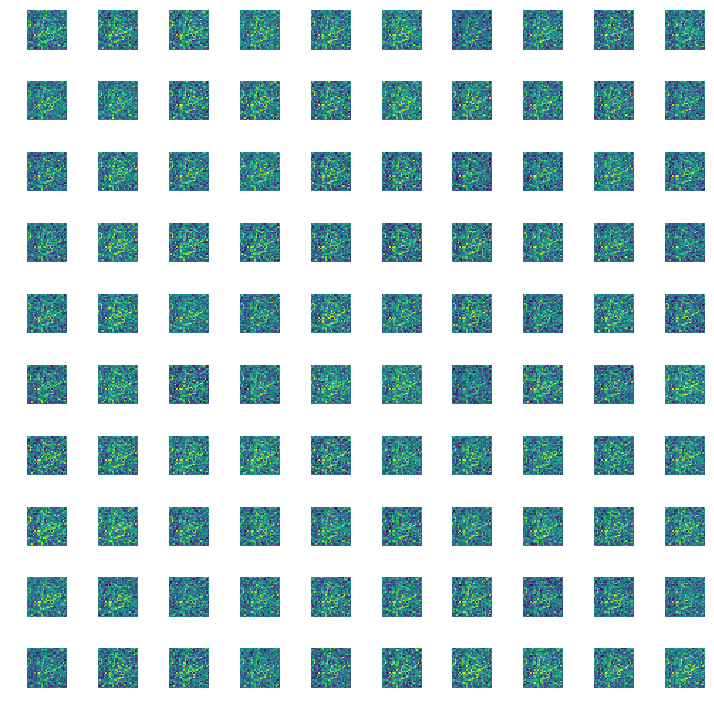

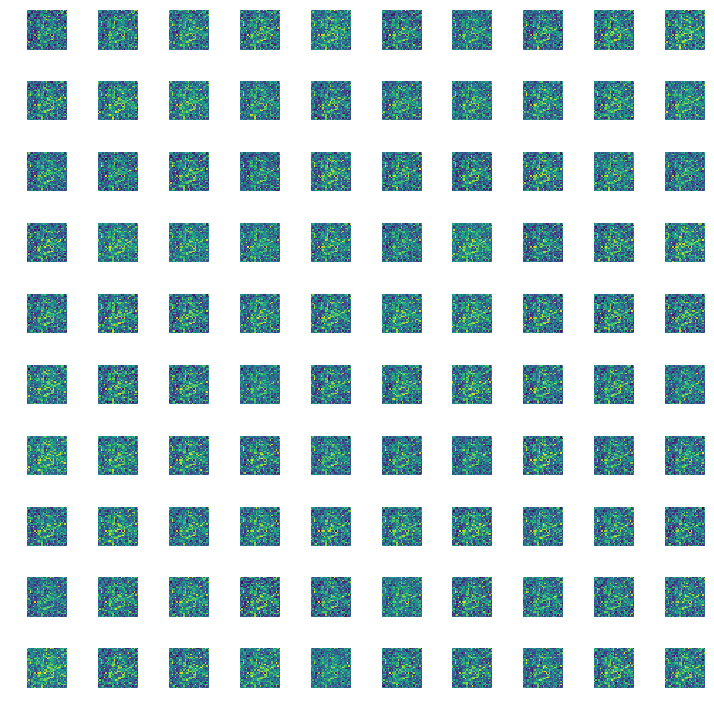

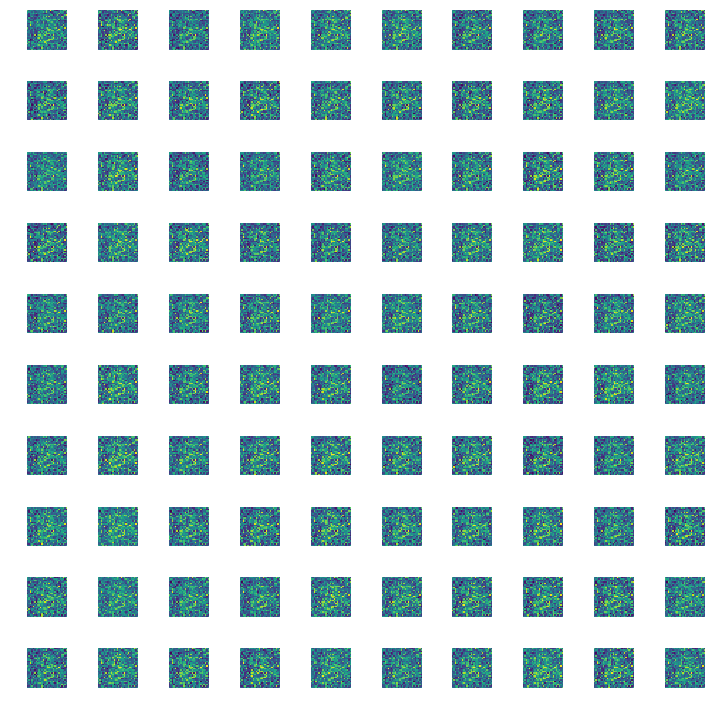

...

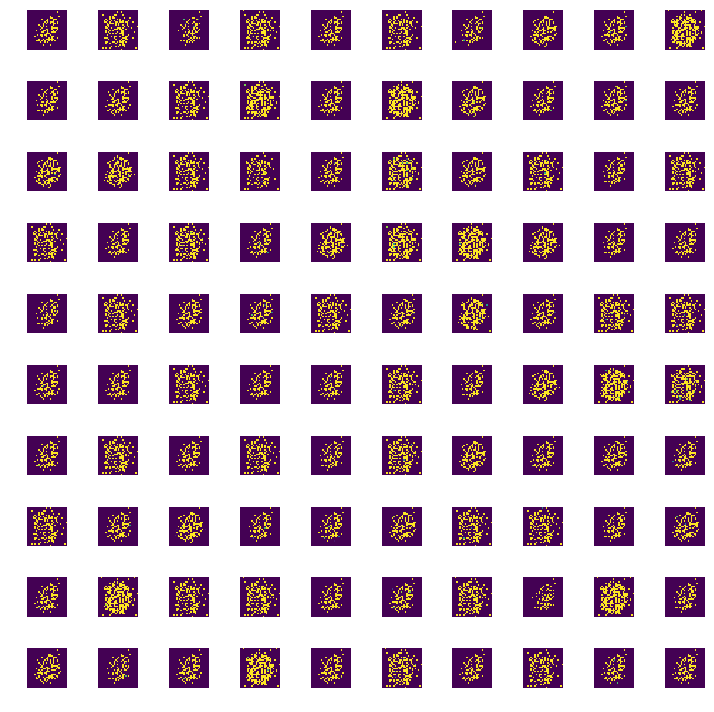

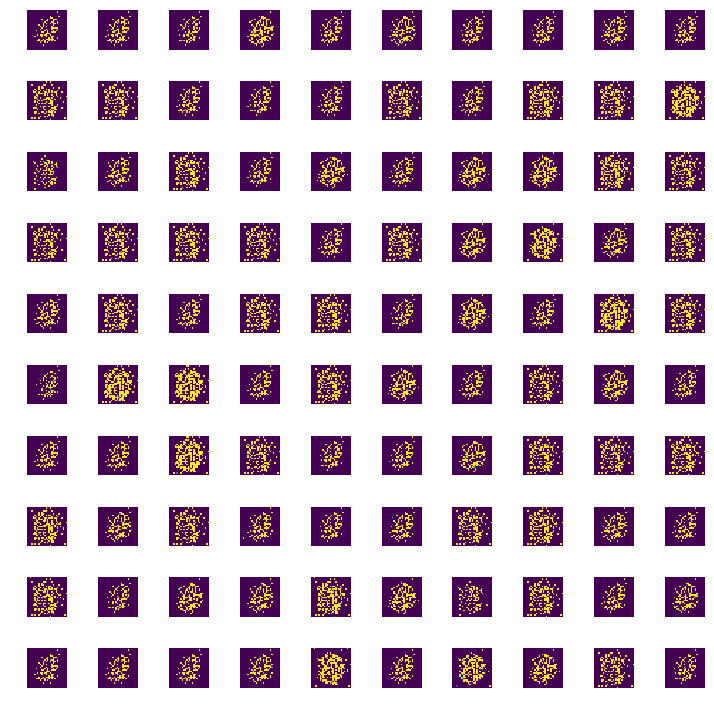

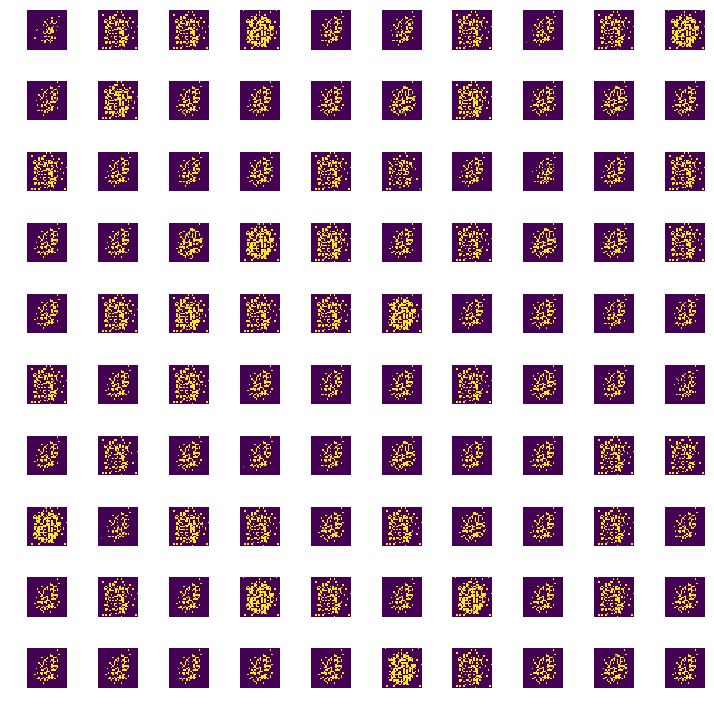

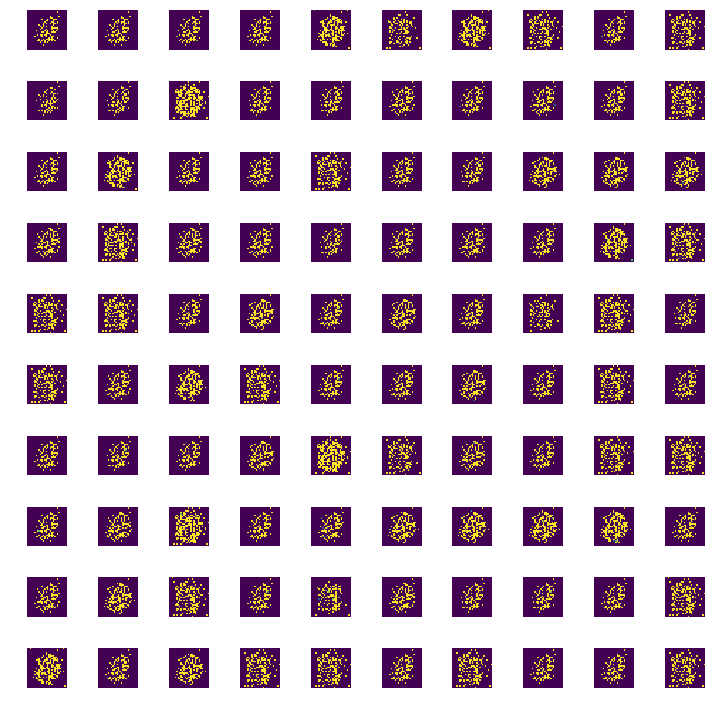

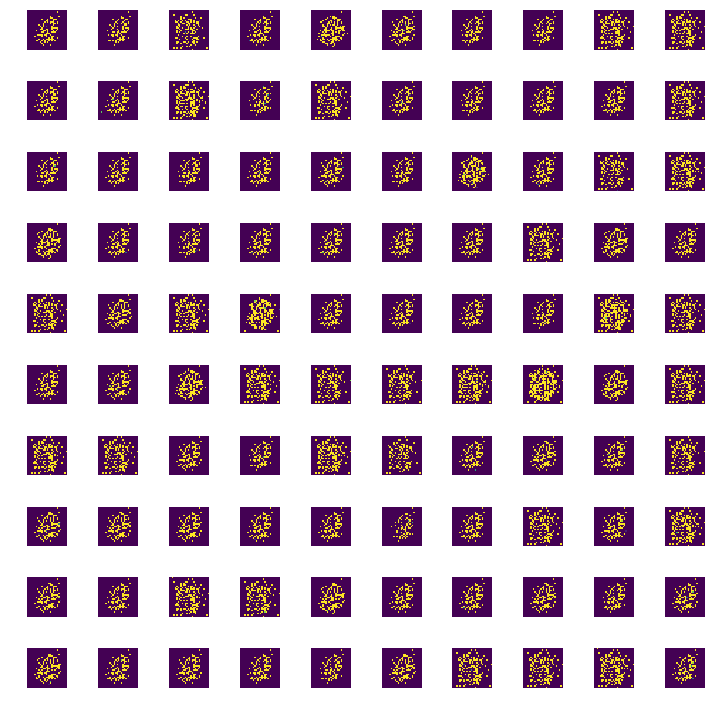

In [11]:
# Train the Gan on 400 epochs in batches of 128
training(200, 64)